In [55]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import math
import pandas as pd
from sklearn.linear_model import LinearRegression
import geopandas as gpd
from shapely.geometry import Point
import contextily as ctx
import csv
from pdf2image import convert_from_path
import os


%matplotlib inline

Convert pdf to png

In [56]:
# PDF to PNG converter for Jupyter notebooks

def convert_pdf_to_png(input_path: str, dpi: int = 300):
    """
    Converts each page of a PDF into a PNG image and saves them.

    Parameters:
        input_path (str): Path to the PDF file.
        dpi (int): Resolution of output images (default: 300).
    """
    if not os.path.isfile(input_path):
        raise FileNotFoundError(f"File '{input_path}' does not exist.")

    output_dir = os.path.dirname(input_path) or '.'
    base_name = os.path.splitext(os.path.basename(input_path))[0]

    try:
        pages = convert_from_path(input_path, dpi=dpi)
    except Exception as e:
        raise RuntimeError(f"Error converting PDF: {e}")

    image_paths = []
    for i, page in enumerate(pages, start=1):
        output_path = os.path.join(output_dir, f"{base_name}_page_{i:03d}.png")
        page.save(output_path, 'PNG')
        image_paths.append(output_path)
        print(f"Saved: {output_path}")

    return image_paths

# Example usage (uncomment and run once)
pdf_file = 'albuquerque.pdf'
png_images = convert_pdf_to_png(pdf_file)


Saved: ./albuquerque_page_001.png


Image preview

(np.float64(-0.5), np.float64(2549.5), np.float64(3299.5), np.float64(-0.5))

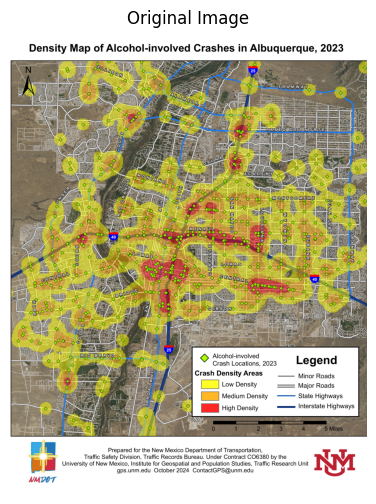

In [57]:
# Use the first page image
if not png_images:
    raise ValueError("No images were generated from the PDF.")
image_path = png_images[0]

# Read and validate image
img = cv2.imread(image_path)
if img is None:
    raise FileNotFoundError(f"Could not read image {image_path}")

# Convert to RGB for plotting
img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

# Display original image
plt.figure(figsize=(8,6))
plt.title('Original Image')
plt.imshow(img_rgb)
plt.axis('off')

Identifiying the color of the points so that we can mask for that color

[[[ 39 253 242]]]
[ 40 255 255]


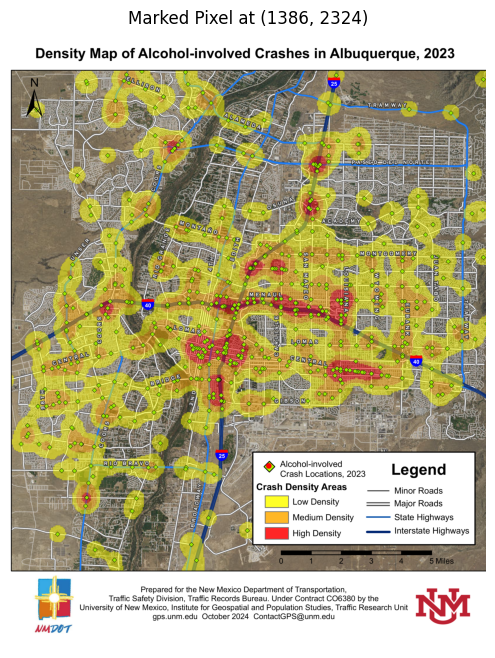

(np.float64(-0.5), np.float64(2549.5), np.float64(3299.5), np.float64(-0.5))

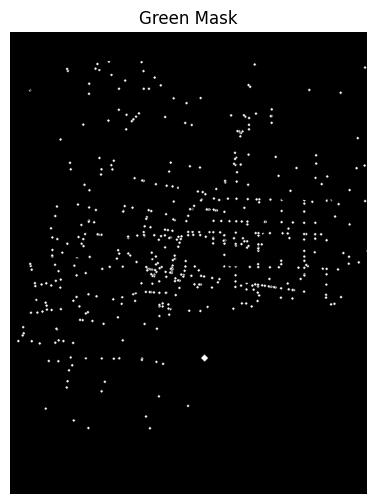

In [58]:
bgr = np.uint8([[[2, 242, 167]]])  # BGR format
hsv = cv2.cvtColor(bgr, cv2.COLOR_BGR2HSV)
print(hsv)

# Define HSV range for target green
lower_hsv = np.array([35, 240, 230], dtype=np.uint8)
upper_hsv = np.array([45, 255, 255], dtype=np.uint8)

# Convert to HSV and apply threshold
hsv = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
mask = cv2.inRange(hsv, lower_hsv, upper_hsv)

# Coordinates (x=2326, y=1389)
x, y = 1386, 2324

# Get color of reference pixel
print(hsv[y, x])

# Draw a red circle at the point
marked_img = img.copy()
cv2.circle(marked_img, (x, y), radius=15, color=(0, 0, 255), thickness=-1)  # Red in BGR

# Convert BGR to RGB for matplotlib
marked_img_rgb = cv2.cvtColor(marked_img, cv2.COLOR_BGR2RGB)

# Display
plt.figure(figsize=(10, 8))
plt.title(f'Marked Pixel at ({x}, {y})')
plt.imshow(marked_img_rgb)
plt.axis('off')
plt.show()

# Display the binary mask
plt.figure(figsize=(8,6))
plt.title('Green Mask')
plt.imshow(mask, cmap='gray')
plt.axis('off')

Find contours of the masked off

(np.float64(-0.5), np.float64(2549.5), np.float64(3299.5), np.float64(-0.5))

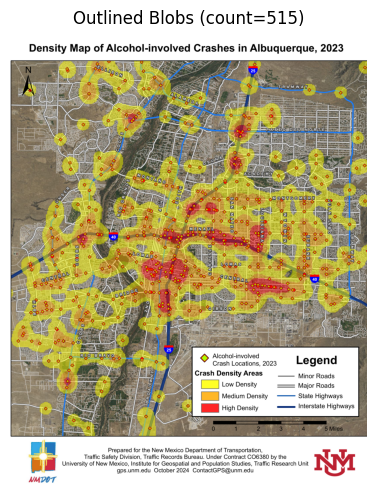

In [59]:
# Find contours of the mask (external only)
contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

# Draw outlines on a copy of the RGB image
outline_img = img_rgb.copy()
cv2.drawContours(outline_img, contours, -1, (255, 0, 0), 2)  # red outlines

# Display outlined blobs and count
plt.figure(figsize=(8,6))
plt.title(f'Outlined Blobs (count={len(contours)})')
plt.imshow(outline_img)
plt.axis('off')

Identify centroids

Found 513 centroids:
  1: (x=999.0, y=2830.0)
  2: (x=559.5, y=2828.5)
  3: (x=455.0, y=2774.0)
  4: (x=971.0, y=2746.0)
  5: (x=254.7, y=2689.7)
  6: (x=1271.3, y=2670.3)
  7: (x=1063.3, y=2602.3)
  8: (x=654.0, y=2566.0)
  9: (x=405.0, y=2539.0)
  10: (x=677.0, y=2498.0)
  11: (x=411.0, y=2494.0)
  12: (x=421.0, y=2416.0)
  13: (x=444.0, y=2380.0)
  14: (x=1093.0, y=2370.0)
  15: (x=1045.3, y=2355.7)
  16: (x=345.0, y=2351.0)
  17: (x=276.5, y=2349.5)
  18: (x=941.5, y=2341.5)
  19: (x=741.0, y=2333.0)
  20: (x=655.0, y=2331.4)
  21: (x=541.4, y=2330.6)
  22: (x=944.1, y=2328.7)
  23: (x=780.3, y=2330.3)
  24: (x=433.3, y=2324.3)
  25: (x=212.0, y=2224.0)
  26: (x=450.5, y=2220.5)
  27: (x=323.0, y=2219.0)
  28: (x=155.0, y=2208.0)
  29: (x=381.0, y=2207.0)
  30: (x=59.0, y=2207.0)
  31: (x=805.0, y=2202.0)
  32: (x=347.0, y=2202.0)
  33: (x=90.0, y=2167.0)
  34: (x=97.8, y=2151.0)
  35: (x=339.0, y=2128.0)
  36: (x=1049.0, y=2119.0)
  37: (x=331.0, y=2119.0)
  38: (x=93.7, y=2107.7)

(np.float64(-0.5), np.float64(2549.5), np.float64(3299.5), np.float64(-0.5))

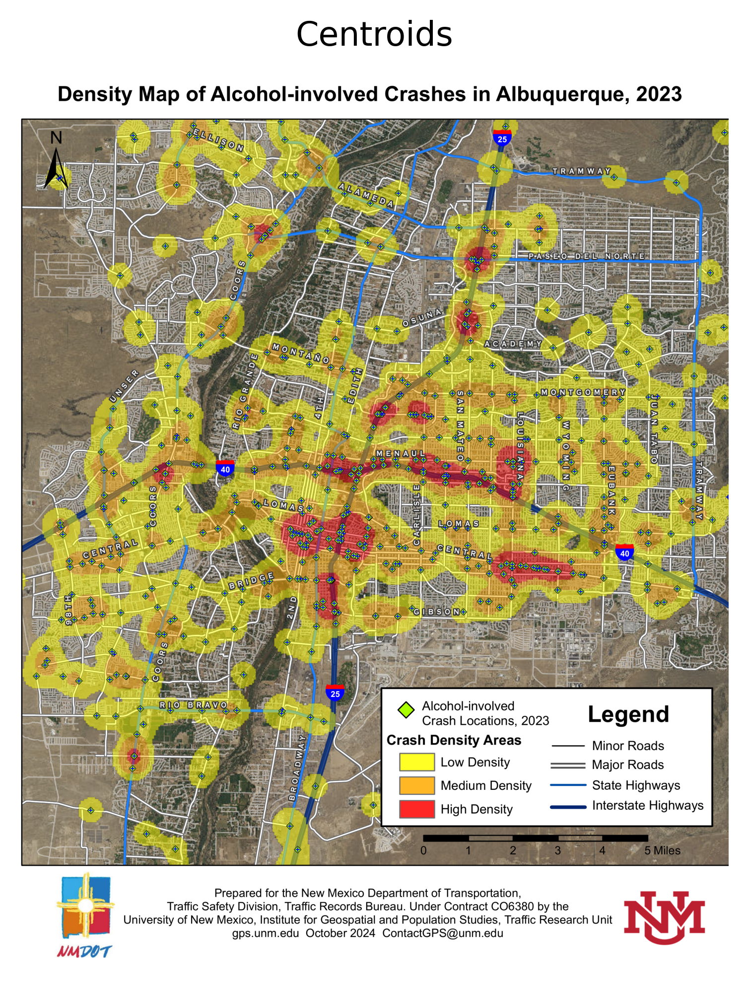

In [60]:

centroids = []
for cnt in contours:
    M = cv2.moments(cnt)
    if M['m00'] != 0:
        cX = M['m10'] / M['m00']
        cY = M['m01'] / M['m00']
        
        # Check if centroid is at least 20 pixels away from (1386, 2324)
        distance = math.hypot(cX - 1386, cY - 2324)
        if distance >= 20:
            centroids.append((cX, cY))

print(f'Found {len(centroids)} centroids:')
for i, (x, y) in enumerate(centroids, 1):
    print(f'  {i}: (x={x:.1f}, y={y:.1f})')

# Visualize centroids on image
centroid_img = img_rgb.copy()
for x, y in centroids:
    cv2.drawMarker(
        centroid_img,
        (int(x), int(y)),
        (0, 0, 255),  # red marker
        markerType=cv2.MARKER_CROSS,
        markerSize=15,
        thickness=2
    )

plt.figure(figsize=(8,6), dpi=400)
plt.title('Centroids')
plt.imshow(centroid_img)
plt.axis('off')


Map the image to actual coordinates using gcp.csv

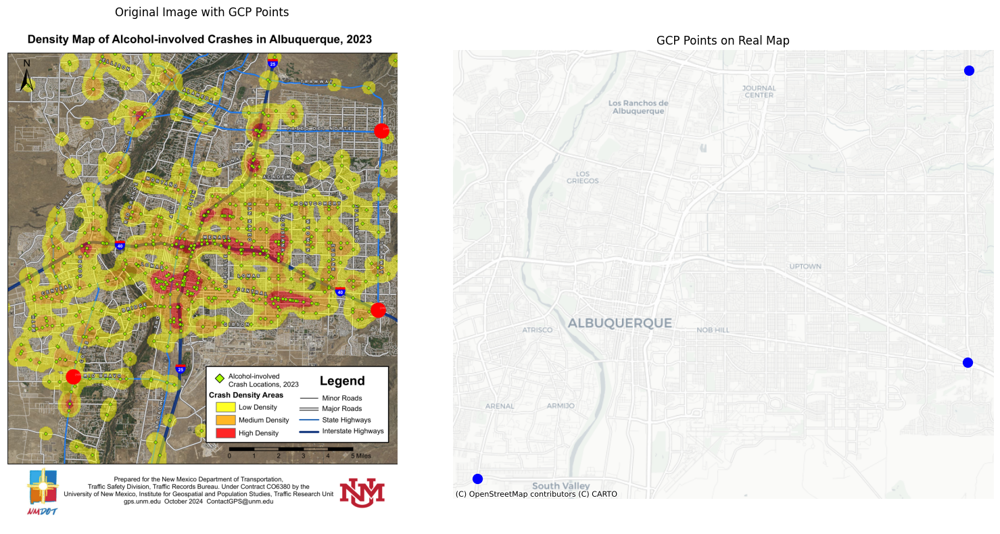

In [61]:
# Load GCPs
gcp_df = pd.read_csv('gcp.csv')

# --- 1. Create the image with GCPs marked ---
gcp_img = img_rgb.copy()
for _, row in gcp_df.iterrows():
    cv2.circle(
        gcp_img,
        (int(row['pixel_x']), int(row['pixel_y'])),
        radius=50,              # adjust size as needed
        color=(255, 0, 0),      # blue
        thickness=-1             # -1 to fill the circle
    )
    cv2.putText(
        gcp_img,
        f"({int(row['pixel_x'])}, {int(row['pixel_y'])})",
        (int(row['pixel_x']) + 10, int(row['pixel_y']) - 10),
        cv2.FONT_HERSHEY_SIMPLEX,
        0.5,
        (255, 255, 255),
        1
    )

# --- 2. Create GCP map plot ---
# Convert to GeoDataFrame
geometry = [Point(lon, lat) for lon, lat in zip(gcp_df['lon'], gcp_df['lat'])]
gcp_gdf = gpd.GeoDataFrame(gcp_df, geometry=geometry, crs='EPSG:4326')
gcp_gdf_3857 = gcp_gdf.to_crs(epsg=3857)

# --- Plot side by side ---
fig, axes = plt.subplots(1, 2, figsize=(16, 8))

# Left: Image with GCPs
axes[0].imshow(gcp_img)
axes[0].set_title("Original Image with GCP Points")
axes[0].axis('off')

# Right: GCPs on basemap
gcp_gdf_3857.plot(ax=axes[1], color='blue', markersize=100)
ctx.add_basemap(axes[1], source=ctx.providers.CartoDB.Positron)
axes[1].set_title("GCP Points on Real Map")
axes[1].axis('off')

plt.tight_layout()
plt.show()

Convert and map centroids to compare to original and save file with crash coordinates

/Users/scottyg/Desktop/Projects/GitHub/nm-2023-alcohol-crash-data/env/lib/python3.9/site-packages/sklearn/linear_model/_base.py:279: RuntimeWarning: divide by zero encountered in matmul
  return X @ coef_ + self.intercept_
/Users/scottyg/Desktop/Projects/GitHub/nm-2023-alcohol-crash-data/env/lib/python3.9/site-packages/sklearn/linear_model/_base.py:279: RuntimeWarning: overflow encountered in matmul
  return X @ coef_ + self.intercept_
/Users/scottyg/Desktop/Projects/GitHub/nm-2023-alcohol-crash-data/env/lib/python3.9/site-packages/sklearn/linear_model/_base.py:279: RuntimeWarning: invalid value encountered in matmul
  return X @ coef_ + self.intercept_
/Users/scottyg/Desktop/Projects/GitHub/nm-2023-alcohol-crash-data/env/lib/python3.9/site-packages/sklearn/linear_model/_base.py:279: RuntimeWarning: divide by zero encountered in matmul
  return X @ coef_ + self.intercept_
/Users/scottyg/Desktop/Projects/GitHub/nm-2023-alcohol-crash-data/env/lib/python3.9/site-packages/sklearn/linear_mo

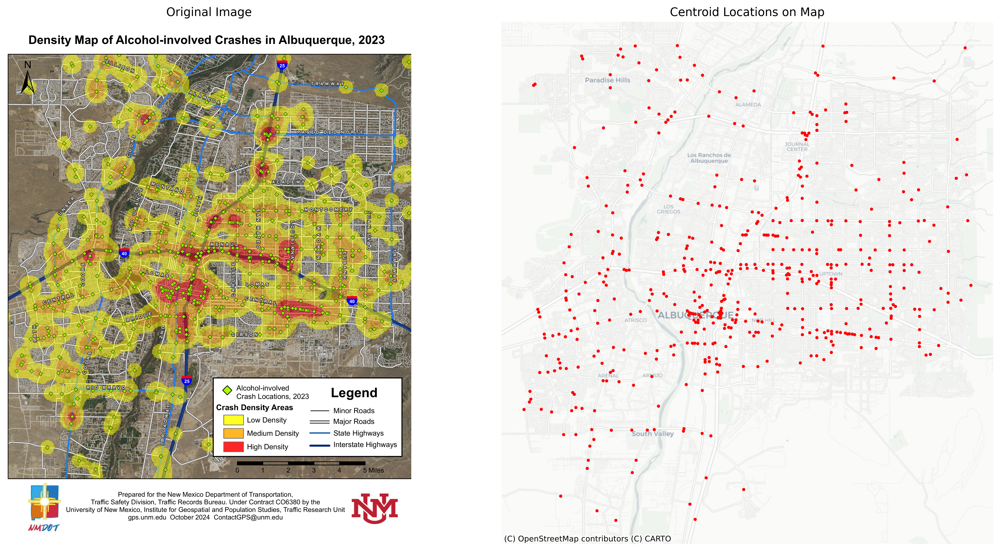

In [62]:
# Check GCP structure
assert {'pixel_x', 'pixel_y', 'lat', 'lon'}.issubset(gcp_df.columns), "CSV must contain pixel_x, pixel_y, lat, lon columns"

# Fit two linear regressions: one for lat, one for lon
X = gcp_df[['pixel_x', 'pixel_y']]
lat_model = LinearRegression().fit(X, gcp_df['lat'])
lon_model = LinearRegression().fit(X, gcp_df['lon'])

# Convert detected centroids to GPS coordinates
centroid_pixels = pd.DataFrame(centroids, columns=['pixel_x', 'pixel_y'])
centroid_pixels['lat'] = lat_model.predict(centroid_pixels[['pixel_x', 'pixel_y']])
centroid_pixels['lon'] = lon_model.predict(centroid_pixels[['pixel_x', 'pixel_y']])

# Convert to GeoDataFrame for mapping
geometry = [Point(xy) for xy in zip(centroid_pixels['lon'], centroid_pixels['lat'])]
gdf = gpd.GeoDataFrame(centroid_pixels, geometry=geometry, crs='EPSG:4326')

# Reproject for basemap overlay
gdf_web_mercator = gdf.to_crs(epsg=3857)

# Create side-by-side plots
fig, axes = plt.subplots(1, 2, figsize=(16, 8), dpi=400)

# Left: Original RGB image
axes[0].imshow(img_rgb)
axes[0].set_title('Original Image')
axes[0].axis('off')

# Right: GPS Centroids on Map
gdf_web_mercator.plot(ax=axes[1], color='red', markersize=5)
ctx.add_basemap(axes[1], source=ctx.providers.CartoDB.Positron)
axes[1].set_title('Centroid Locations on Map')
axes[1].axis('off')

plt.tight_layout()
plt.show()

# Save centroid geocoordinates to CSV
centroid_pixels[['lat', 'lon']].to_csv('centroid_geocoordinates.csv', index=False)
